In [1]:
!pip install --upgrade google-api-python-client

     ---------------------------------------- 10.4/10.4 MB 2.7 MB/s eta 0:00:00
     -------------------------------------- 115.6/115.6 kB 7.0 MB/s eta 0:00:00
     ------------------------------------ 211.7/211.7 kB 515.1 kB/s eta 0:00:00
     -------------------------------------- 525.4/525.4 kB 5.5 MB/s eta 0:00:00


ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\Python39\\Lib\\site-packages\\google\\~rotobuf\\internal\\_api_implementation.cp39-win_amd64.pyd'
Consider using the `--user` option or check the permissions.


[notice] A new release of pip available: 22.2.2 -> 22.3
[notice] To update, run: python.exe -m pip install --upgrade pip


  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.18.0
    Uninstalling protobuf-3.18.0:
      Successfully uninstalled protobuf-3.18.0


In [5]:
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google.colab'

In [6]:
!pip install plotly --upgrade -q


[notice] A new release of pip available: 22.2.2 -> 22.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [7]:
!pip install scikit-learn==0.24.2 -q

ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'C:\\Python39\\Lib\\site-packages\\~klearn\\.libs\\vcomp140.dll'
Consider using the `--user` option or check the permissions.


[notice] A new release of pip available: 22.2.2 -> 22.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
import pandas as pd
import numpy as np

# plots
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
%matplotlib inline
import plotly.offline as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.tools as tls
import plotly.figure_factory as ff
import plotly.express as px
import plotly.graph_objs as go
py.init_notebook_mode(connected=True)

# sklearn
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler, LabelEncoder
from google.colab import files

# Data processing, metrics and modeling
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.model_selection import GridSearchCV, cross_val_score, train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import precision_score, recall_score, confusion_matrix,  roc_curve, precision_recall_curve, accuracy_score, roc_auc_score
import lightgbm as lgbm
from sklearn.ensemble import VotingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import roc_curve,auc
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_predict

# Stats
import scipy.stats as ss
from scipy import interp
from scipy.stats import randint as sp_randint
from scipy.stats import uniform as sp_uniform

# warnings
import warnings
warnings.filterwarnings('ignore')

In [ ]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
import IPython

IPython.get_ipython().events.register('pre_run_cell', configure_plotly_browser_state)

# Exploratory Analysis

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Personal Projects/diabetes.csv')
df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB


In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Pregnancies,768.0,3.845052,3.369578,0.000,1.00000,3.0000,6.00000,17.00
Glucose,768.0,120.894531,31.972618,0.000,99.00000,117.0000,140.25000,199.00
BloodPressure,768.0,69.105469,19.355807,0.000,62.00000,72.0000,80.00000,122.00
SkinThickness,768.0,20.536458,15.952218,0.000,0.00000,23.0000,32.00000,99.00
Insulin,768.0,79.799479,115.244002,0.000,0.00000,30.5000,127.25000,846.00
BMI,768.0,31.992578,7.884160,0.000,27.30000,32.0000,36.60000,67.10
DiabetesPedigreeFunction,768.0,0.471876,0.331329,0.078,0.24375,0.3725,0.62625,2.42
Age,768.0,33.240885,11.760232,21.000,24.00000,29.0000,41.00000,81.00
Outcome,768.0,0.348958,0.476951,0.000,0.00000,0.0000,1.00000,1.00


On these columns, a value of zero does not make sense and thus indicates missing value.

In [ ]:
df.isnull().sum()

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

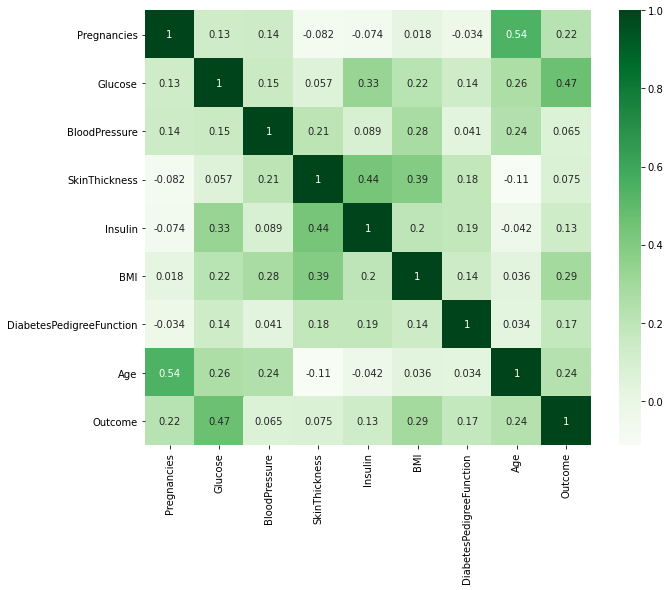

In [ ]:
fig_dims = (10, 8)
fig, ax = plt.subplots(figsize=fig_dims)
corrMatrix = df.corr()
sns.heatmap(corrMatrix, annot=True, ax=ax, cmap="Greens")

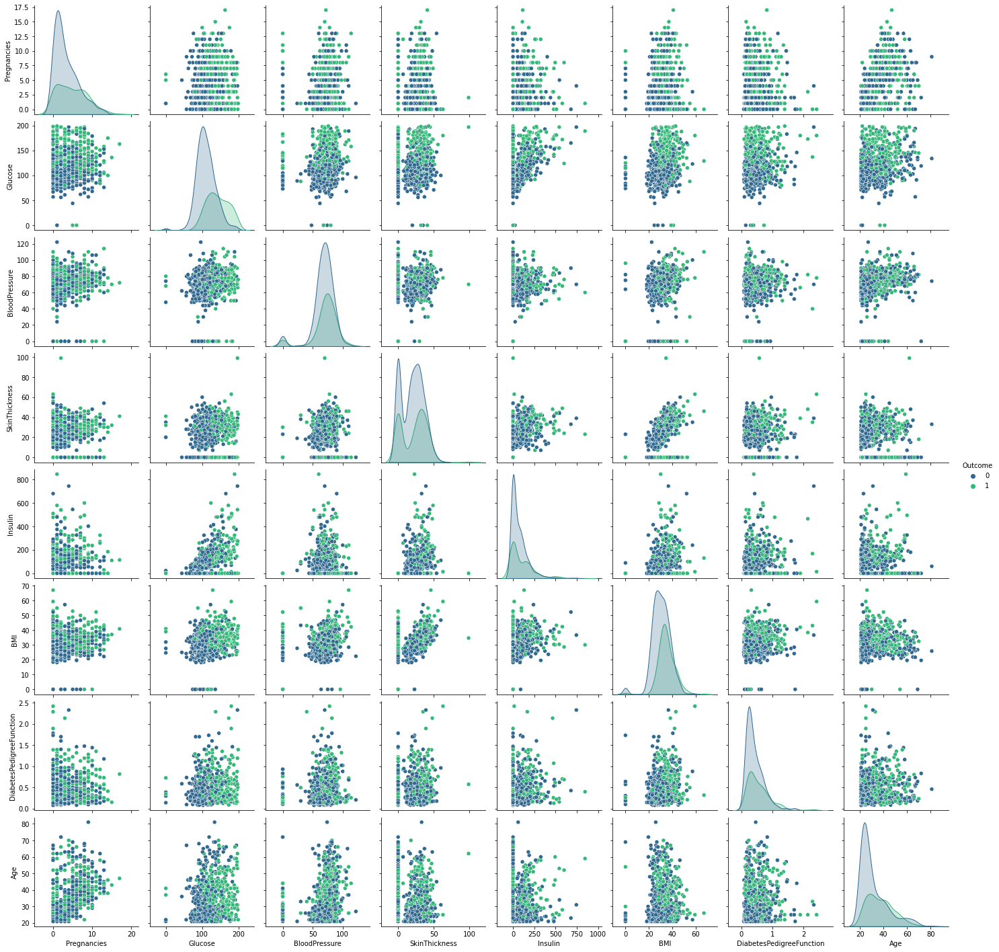

In [ ]:
sns.pairplot(df, hue="Outcome", palette="viridis")

In [ ]:
def highlight_min(s):    
    is_max = s == s.min()
    return ['background-color: limegreen' if v else '' for v in is_max]
df.describe().T.style.apply(highlight_min, subset=['min'])

,count,mean,std,min,25%,50%,75%,max
Pregnancies,768.000000,3.845052,3.369578,0.000000,1.000000,3.000000,6.000000,17.000000
Glucose,768.000000,120.894531,31.972618,0.000000,99.000000,117.000000,140.250000,199.000000
BloodPressure,768.000000,69.105469,19.355807,0.000000,62.000000,72.000000,80.000000,122.000000
SkinThickness,768.000000,20.536458,15.952218,0.000000,0.000000,23.000000,32.000000,99.000000
Insulin,768.000000,79.799479,115.244002,0.000000,0.000000,30.500000,127.250000,846.000000
BMI,768.000000,31.992578,7.884160,0.000000,27.300000,32.000000,36.600000,67.100000
DiabetesPedigreeFunction,768.000000,0.471876,0.331329,0.078000,0.243750,0.372500,0.626250,2.420000
Age,768.000000,33.240885,11.760232,21.000000,24.000000,29.000000,41.000000,81.000000
Outcome,768.000000,0.348958,0.476951,0.000000,0.000000,0.000000,1.000000,1.000000


📌 The highlighted value doesn't make sense and may indicates missing values except for the "Pregnancies" and "Outcome" features

In [ ]:
df_copy = df.copy(deep = True)
df_copy[['Glucose','BloodPressure','SkinThickness','Insulin','BMI']] = df_copy[['Glucose','BloodPressure','SkinThickness','Insulin','BMI']].replace(0,np.NaN)

## showing the count of Nans
print(df_copy.isnull().sum())

Pregnancies                   0
Glucose                       5
BloodPressure                35
SkinThickness               227
Insulin                     374
BMI                          11
DiabetesPedigreeFunction      0
Age                           0
Outcome                       0
dtype: int64


Insulin: In a rare situation a person can have zero insulin but by observing the data, we can find that there is a total of 374 counts.

In [ ]:
percent_missing = df_copy.isnull().mean().round(4) * 100

In [ ]:
trace = go.Bar(x = percent_missing.index, y = percent_missing.values, opacity = 0.8, text = percent_missing.values.round(4),  textposition = 'auto',marker=dict(color = '#90EE90',
        line=dict(color='#000000',width=1.25)))

layout = dict(title =  "Missing Values (count & %)")

fig = dict(data = [trace], layout=layout)
py.iplot(fig)

## Check Dependent Variable Distribution

In [ ]:
#------------COUNT-----------------------
def target_count(data):
    trace = go.Bar( x = data['Outcome'].value_counts().values.tolist(), 
                    y = ['healthy','diabetic' ], 
                    orientation = 'h', 
                    text=data['Outcome'].value_counts().values.tolist(), 
                    textfont=dict(size=15),
                    textposition = 'auto',
                    opacity = 0.8,marker=dict(
                    color=['#00FA9A', '#2F4F4F'],
                    line=dict(color='#000000',width=1.5)))

    layout = dict(title =  'Count of Outcome variable')

    fig = dict(data = [trace], layout=layout)
    py.iplot(fig, filename="barh.html")
    

#------------PERCENTAGE-------------------
def target_percent(data):
    trace = go.Pie(labels = ['healthy','diabetic'], values = data['Outcome'].value_counts(), 
                   textfont=dict(size=15), opacity = 0.8,
                   marker=dict(colors=['#00FA9A', '#2F4F4F'], 
                               line=dict(color='#000000', width=1.5)))


    layout = dict(title =  'Distribution of Outcome variable')

    fig = dict(data = [trace], layout=layout)
    py.iplot(fig, filename="piechart.html")
    go.Figure.write_html(fig,"file.html")
    # files.download("file.html")

In [ ]:
target_count(df)
target_percent(df)

minority class is 0, in this case we will use upsample techniques

In [ ]:
from sklearn.utils import resample, shuffle

zero  = df_copy[df_copy['Outcome']==0]   
one = df_copy[df_copy['Outcome']==1]  

# n_samples = 500 means we want 500 sample of class 1, since there are 500 samples of class 0
df_minority_upsampled = resample(one, replace = True, n_samples = 500) 
# concatenate
df_copy = pd.concat([zero, df_minority_upsampled])

df_copy = shuffle(df_copy)

In [ ]:
(df_copy['Outcome']==0).sum()

500

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f1dabafae10>,
      dtype=object)

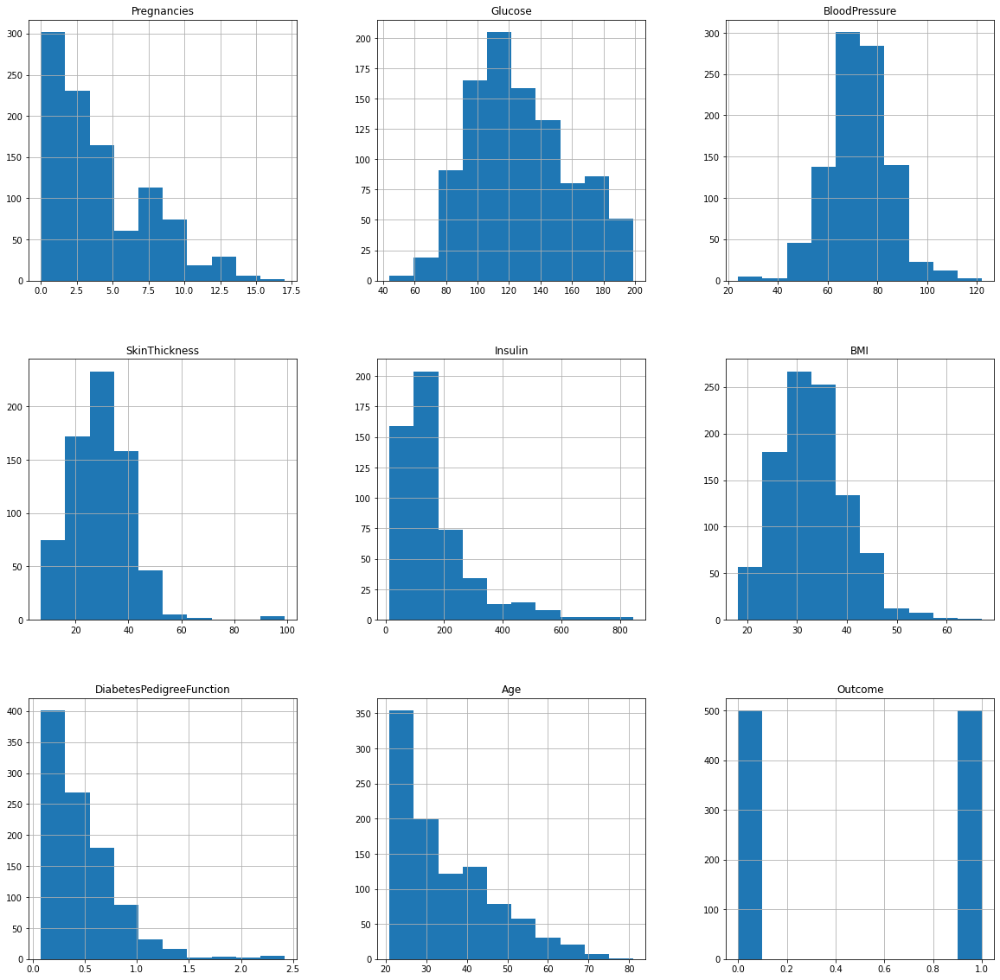

In [ ]:
df_copy.hist(figsize = (20,20))

### Impute Missing Values

In [ ]:
df_copy['Glucose'].fillna(df_copy['Glucose'].mean(), inplace = True)
df_copy['SkinThickness'].fillna(df_copy['SkinThickness'].median(), inplace = True)
df_copy['BloodPressure'].fillna(df_copy['BloodPressure'].mean(), inplace = True)
df_copy['Insulin'].fillna(df_copy['Insulin'].median(), inplace = True)
df_copy['BMI'].fillna(df_copy['BMI'].median(), inplace = True)

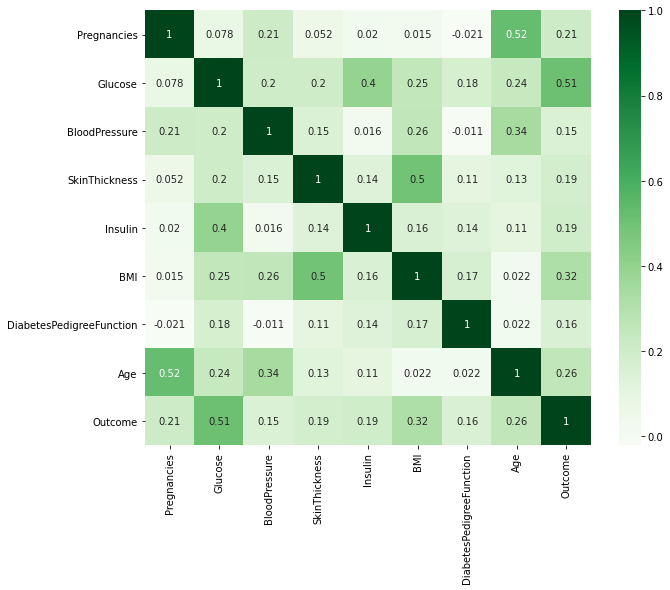

In [ ]:
fig_dims = (10, 8)
fig, ax = plt.subplots(figsize=fig_dims)
corrMatrix = df_copy.corr()
sns.heatmap(corrMatrix, annot=True, ax=ax, cmap="Greens")

## Univariate Analysis

In [ ]:
# Diabetes/Healthy
D = df_copy[(df_copy['Outcome'] != 0)]
H = df_copy[(df_copy['Outcome'] == 0)]

In [ ]:
def plot_distribution(data_select, size_bin) :  
    
    tmp1 = D[data_select]
    tmp2 = H[data_select]
    hist_data = [tmp1, tmp2]
    
    group_labels = ['diabetic', 'healthy']
    colors = ['#00FA9A', '#2F4F4F']

    fig = ff.create_distplot(hist_data, group_labels, colors = colors, show_hist = True, 
                             bin_size = size_bin, curve_type='kde')
    
    fig['layout'].update(title = data_select)

    py.iplot(fig)

In [ ]:
def plot_outliers(df, feat):
    
    trace0 = go.Box(
        y = df[feat],
        name = "All Points",
        jitter = 0.3,
        pointpos = -1.8,
        boxpoints = 'all',
        marker = dict(
            color = 'rgb(32,178,170)'),
        line = dict(
            color = 'rgb(32,178,170)')
    )

    trace1 = go.Box(
        y = df[feat],
        name = "Only Whiskers",
        boxpoints = False,
        marker = dict(
            color = 'rgb(0,128,128)'),
        line = dict(
            color = 'rgb(0,128,128)')
    )

    trace2 = go.Box(
        y = df[feat],
        name = "Suspected Outliers",
        boxpoints = 'suspectedoutliers',
        marker = dict(
            color = 'rgb(0,250,154)',
            outliercolor = '#FF69B4',
            line = dict(
                outliercolor = '#FF69B4',
                outlierwidth = 2)),
        line = dict(
            color = 'rgb(0,250,154)')
    )

    trace3 = go.Box(
        y = df[feat],
        name = "Whiskers and Outliers",
        boxpoints = 'outliers',
        marker = dict(
            color = 'rgb(47,79,79)'),
        line = dict(
            color = 'rgb(47,79,79)')
    )

    data = [trace0,trace1,trace2,trace3]

    layout = go.Layout(
        title = "{} Outliers".format(feat)
    )

    fig = go.Figure(data=data,layout=layout)
    py.iplot(fig)

In [ ]:
features = [i for i in df_copy.columns]

In [ ]:
def plot_all_feature():
    for feat in features[:-1]:
        plot_distribution(feat, 0)
        plot_outliers(df_copy, feat)
    plot_outliers(df_copy, features[-1])

In [ ]:
plot_all_feature()

# Multivariate Analysis

What is "multivariate"?

Multivariate data analysis is a set of statistical models that examine patterns in multidimensional data by considering, at once, several data variables. It is an expansion of bivariate data analysis, which considers only two variables in its models. As multivariate models consider more variables, they can examine more complex phenomena and find data patterns that more accurately represent the real world

What is "bivariate"?

Bivariate analysis is a kind of statistical analysis when two variables are observed against each other. One of the variables will be dependent and the other is independent.

In [ ]:
# #2F4F4F
def feat_cor(data_x, data_y):
  fig = px.scatter(df, x=data_x, y=data_y,
              color='Outcome',size_max=18,color_continuous_scale=['#00FA9A', 'blue'])
  fig.update_layout({"template":"plotly_dark"})
  fig.show()
  fig.write_html("feat_corr.html")

In [ ]:
for i in range(len(features)):
  for z in range(i+1, len(features)):
    feat_cor(features[i], features[z])

# Handling Outliers

In [ ]:
features = ['Pregnancies',
 'Glucose',
 'BloodPressure',
 'SkinThickness',
 'Insulin',
 'BMI',
 'DiabetesPedigreeFunction',
 'Age',
 'Outcome']

In [ ]:
def removeOutliers(df_out, feature, drop=False):

    valueOfFeature = df_out[feature]
    
    # Q1 (25th percentile) for the given feature
    Q1 = np.percentile(valueOfFeature, 25.)

    # Q3 (75th percentile) for the given feature
    Q3 = np.percentile(valueOfFeature, 75.)
    
    step = 1.5*(Q3-Q1)

    outliers = valueOfFeature[~((valueOfFeature >= Q1 - step) & (valueOfFeature <= Q3 + step))].index.tolist()
    feature_outliers = valueOfFeature[~((valueOfFeature >= Q1 - step) & (valueOfFeature <= Q3 + step))].values

    # Remove the outliers, if specified
    print ("Number of outliers (include duplicates): {} and outliers: {}".format(len(outliers), feature_outliers))
    if drop:
        good_data = df_out.drop(df_out.index[outliers]).reset_index(drop = True)
        print ("New dataset with removed outliers has {} samples with {} features each.".format(*good_data.shape))
        return good_data
    else: 
        print ("Nothing happens, df.shape = ", df_out.shape)
        return df_out

In [ ]:
clean_df = removeOutliers(df_copy, 'Pregnancies', True)

Number of outliers (include duplicates): 8 and outliers: [15 17 15 15 15 15 17 14]
New dataset with removed outliers has 996 samples with 9 features each.


In [ ]:
clean_df = removeOutliers(clean_df, 'Glucose', True)

Number of outliers (include duplicates): 0 and outliers: []
New dataset with removed outliers has 996 samples with 9 features each.


In [ ]:
clean_df = removeOutliers(clean_df, 'BloodPressure', True)

Number of outliers (include duplicates): 23 and outliers: [106. 108. 114. 114.  30. 104. 110. 110.  24. 106. 108.  30. 110.  40.
  38.  30.  40. 122. 110. 106.  30. 110. 106.]
New dataset with removed outliers has 973 samples with 9 features each.


remove skin thickness and insulin would mean losing valuable information. And in this case “skin thickness” and “insulin” columns mean to have a lot of invalid points. But it might work for “BMI”, “glucose ”and “blood pressure” data points.

In [ ]:
clean_df = removeOutliers(clean_df, 'SkinThickness', False)

Number of outliers (include duplicates): 154 and outliers: [14. 42. 42. 13. 44. 42. 99. 16.  7. 10. 13. 11. 47. 45.  7. 16. 14. 42.
 43. 12. 46. 12. 16. 15. 11. 52. 13. 15. 16. 44. 54. 43. 42. 54. 16. 49.
 13. 44.  8. 10. 47. 43. 45. 42. 50. 48. 15. 42. 15. 10. 12. 43. 50. 14.
 15. 11. 15.  7. 15. 13. 43. 14. 12. 99. 12. 13. 13. 45. 46. 11. 42. 45.
 13. 12. 46. 15. 49. 11. 13. 99. 56.  7. 42. 63. 14. 15. 42. 48.  7. 47.
 44. 56. 44. 45. 14. 13. 45. 43. 48. 15. 63. 43. 14. 45. 60. 13. 46. 48.
 42. 10. 12. 42.  8. 42. 45. 43. 14. 11. 52. 42. 15. 46. 13. 13. 45. 14.
 42. 16. 51. 42. 15. 45. 13. 47. 43. 44. 15. 49. 15. 43. 10. 43. 13.  7.
 15. 50. 15. 48. 48. 48. 14. 45. 14. 13.]
Nothing happens, df.shape =  (973, 9)


In [ ]:
clean_df = removeOutliers(clean_df, 'Insulin', False)

Number of outliers (include duplicates): 459 and outliers: [402.  44.  49.  88.  64. 105. 478.  96. 321. 110. 110. 105. 360. 140.
  16. 250.  95.  99. 196. 106. 285.  96. 116.  53. 112. 126. 180.  76.
  85. 100. 326.  50. 167. 370. 278.  15. 190.  64.  64.  63. 215. 170.
 125. 120. 120. 543. 110. 304. 392. 115. 330. 220.  63. 100. 140. 271.
  45. 258. 168. 144.  58. 200. 342.  71. 119.  75. 140.  86.  92.  57.
 328. 150.  70. 270. 178.  58.  52. 126. 225. 115. 145.  36.  82.  54.
  57.  48. 165.  37. 155. 375. 510. 274. 325. 158. 145. 190.  66.  90.
 155.  71. 120.  41.  37.  48. 545.  76. 182.  94. 165.  36. 277. 120.
 335. 144. 175. 230.  67. 191.  73. 171. 176.  71. 321. 168. 140. 171.
 237. 165. 540.  58.  56.  88. 392. 166. 485. 680.  85.  78. 325.  36.
 100. 204. 207.  66.  94. 210. 285. 168. 846.  76. 150. 180. 145. 120.
 176. 152. 258. 152. 140. 182. 167.  71.  53. 293. 110. 108. 272.  72.
 110. 115. 310. 170. 228. 140. 116. 205.  77. 325.  50. 415.  66. 194.
  46.  42.  40.  4

In [ ]:
clean_df = removeOutliers(clean_df, 'BMI', True)

Number of outliers (include duplicates): 9 and outliers: [52.9 52.3 53.2 59.4 53.2 59.4 52.3 52.9 57.3]
New dataset with removed outliers has 964 samples with 9 features each.


In [ ]:
clean_df = removeOutliers(clean_df, 'DiabetesPedigreeFunction', True)

Number of outliers (include duplicates): 27 and outliers: [1.893 1.321 1.4   1.699 1.318 1.321 1.781 1.353 1.461 1.698 2.329 1.268
 1.282 1.731 2.137 1.893 1.39  1.6   1.476 2.137 1.391 1.394 2.137 1.441
 1.282 1.394 1.394]
New dataset with removed outliers has 937 samples with 9 features each.


In [ ]:
clean_df = removeOutliers(clean_df, 'Age', False)

Number of outliers (include duplicates): 6 and outliers: [70 70 70 81 70 72]
Nothing happens, df.shape =  (937, 9)


In [ ]:
print('Original df.shape: {},-- New df.shape: {}, -- {} rows removed -- which is {}% of our data'.format(df_copy.shape[0], clean_df.shape[0],
                                                              df_copy.shape[0]-clean_df.shape[0],
                                                        (df_copy.shape[0]-clean_df.shape[0])/df_copy.shape[0]*100))

Original df.shape: 1000,-- New df.shape: 937, -- 63 rows removed -- which is 6.3% of our data


# Feature Engineering
Now, its time to add important features to the dataset discover some effective features before fitting it into machine learning models.

Feature 1 : BMI Descriptor I m adding BMI Descriptor feature as we know : If you have a BMI of:

Under 18.5 – you are considered underweight and possibly malnourished.
18.5 to 24.9 – you are within a healthy weight range for young and middle-aged adults.
25.0 to 29.9 – you are considered overweight.
Over 30 – you are considered obese.

In [ ]:
def set_bmi(row):
    if row["BMI"] < 18.5:
        return "Under"
    elif row["BMI"] >= 18.5 and row["BMI"] <= 24.9:
        return "Healthy"
    elif row["BMI"] >= 25 and row["BMI"] <= 29.9:
        return "Over"
    elif row["BMI"] >= 30:
        return "Obese"

In [ ]:
clean_df_fe = clean_df.assign(BM_DESC=clean_df.apply(set_bmi, axis=1))

clean_df_fe.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome,BM_DESC
0,9,124.000000,70.0,33.0,402.0,35.4,0.282,34,0,Obese
1,3,111.000000,58.0,31.0,44.0,29.5,0.430,22,0,Over
2,1,126.674395,68.0,35.0,130.0,32.0,0.389,22,0,Obese
3,4,171.000000,72.0,30.0,130.0,43.6,0.479,26,1,Obese
4,6,107.000000,88.0,30.0,130.0,36.8,0.727,31,0,Obese


Feature 2: Insulin Indicative Range If insulin level (2-Hour serum insulin (mu U/ml)) is >= 16 and <= 166, then it is normal range else it is considered as Abnormal

In [ ]:
def set_insulin(row):
    if row["Insulin"] >= 16 and row["Insulin"] <= 166:
        return "Normal"
    else:
        return "Abnormal"

In [ ]:
clean_df_fe = clean_df_fe.assign(INSULIN_DESC=clean_df_fe.apply(set_insulin, axis=1))

clean_df_fe.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome,BM_DESC,INSULIN_DESC
0,9,124.000000,70.0,33.0,402.0,35.4,0.282,34,0,Obese,Abnormal
1,3,111.000000,58.0,31.0,44.0,29.5,0.430,22,0,Over,Normal
2,1,126.674395,68.0,35.0,130.0,32.0,0.389,22,0,Obese,Normal
3,4,171.000000,72.0,30.0,130.0,43.6,0.479,26,1,Obese,Normal
4,6,107.000000,88.0,30.0,130.0,36.8,0.727,31,0,Obese,Normal


# Prepared data for modeling

In [ ]:
# Feature Engineered DataFrame
X_fe = pd.get_dummies(clean_df_fe)
cols_drop = ['Outcome']
X_fe = X_fe.drop(cols_drop, axis=1)
y_fe = clean_df['Outcome']

In [ ]:
# Normal DataFrame
cols_drop = ['Outcome']
X = clean_df.drop(cols_drop, axis=1)
y = clean_df['Outcome']

In [ ]:
X.shape, y.shape, X_fe.shape, y_fe.shape

((937, 8), (937,), (937, 14), (937,))

In [ ]:
# Splitting Training and Testing data (inc feature engineering)
X_train_fe, X_test_fe, y_train_fe, y_test_fe = train_test_split(X_fe, y_fe,
                                                   test_size=0.20,
                                                   random_state=42,
                                                   stratify=clean_df['Outcome'])

In [ ]:
# Splitting Training and Testing data
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                   test_size=0.20,
                                                   random_state=42,
                                                   stratify=clean_df['Outcome'])

## Select Columns for scaling

In [ ]:
num_col = clean_df.select_dtypes(['int64', 'float64']).columns
num_col = ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']

In [ ]:
bin_col = X_train_fe.select_dtypes(['uint8']).columns
bin_col = ['BM_DESC_Healthy', 'BM_DESC_Obese', 'BM_DESC_Over', 'BM_DESC_Under',
       'INSULIN_DESC_Abnormal', 'INSULIN_DESC_Normal']

In [ ]:
# Scaling the data
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import joblib
mm_scaler = MinMaxScaler()
sd_scaler = StandardScaler()

# scaled data and return dataframe
def scaling_method_train(scaler, data, save=False):
  df = pd.DataFrame(scaler.fit_transform(data[num_col]), columns=data[num_col].columns, index=data[num_col].index)
  if save==True:
    joblib.dump(scaler, f'{scaler}.pkl')
  return df

def scaling_method_test(scaler, data):
  df = pd.DataFrame(scaler.transform(data[num_col]), columns=data[num_col].columns, index=data[num_col].index)
  return df

In [ ]:
# scaled data
X_train_mm = scaling_method_train(mm_scaler, X_train, save=True)
X_train_sd = scaling_method_train(sd_scaler, X_train, save=True)
X_test_mm = scaling_method_train(mm_scaler, X_test)
X_test_sd = scaling_method_train(sd_scaler, X_test)

In [ ]:
# X_train feature engineered + minmax scaler
X_train_fe_mm = X_train_fe.drop(columns = num_col, axis = 1)
X_train_fe_mm = X_train_fe_mm.merge(X_train_mm, left_index=True, right_index=True, how = "left")
# X_train feature engineerd + standard scaler
X_train_fe_sd = X_train_fe.drop(columns = num_col, axis = 1)
X_train_fe_sd = X_train_fe_sd.merge(X_train_sd, left_index=True, right_index=True, how = "left")

In [ ]:
# X_test feature engineered + minmax scaler
X_test_fe_mm = X_test_fe.drop(columns = num_col, axis = 1)
X_test_fe_mm = X_test_fe_mm.merge(X_test_mm, left_index=True, right_index=True, how = "left")
# X_test feature engineerd + standard scaler
X_test_fe_sd = X_test_fe.drop(columns = num_col, axis = 1)
X_test_fe_sd = X_test_fe_sd.merge(X_test_sd, left_index=True, right_index=True, how = "left")

In [ ]:
# reset index for later usage
X_train_mm_eval = X_train_mm.reset_index(drop=True)
X_train_sd_eval = X_train_sd.reset_index(drop=True)
y_train_eval = y_train.reset_index(drop=True)

X_train_fe_mm_eval = X_train_fe_mm.reset_index(drop=True)
X_train_fe_sd_eval = X_train_fe_sd.reset_index(drop=True)

X_train_eval = X_train.reset_index(drop=True)
X_test_eval = X_test.reset_index(drop=True)

In [ ]:
# load joblib scaler
mm_scaler = joblib.load('/content/MinMaxScaler().pkl')
sd_scaler = joblib.load('/content/StandardScaler().pkl')

- X_train, X_test - no feature engineering or scaled
- X_train_mm, X_test_mm - scaled with min max scaler
- X_train_sd, X_test_sd - scaled with standard scaler
- X_train_fe_mm, X_test_fe_mm - apply feature engineering and scaled with min max scaler
- X_train_fe_mm, X_test_fe_mm - apply feature engineering and scaled with Standard scaler

# Modeling and Evaluation

Visualize model evaluation

In [ ]:
def model_performance(model, subtitle, X, y):   
    #Kfold
    cv = KFold(n_splits=5, shuffle=False)
    y_real = []
    y_proba = []
    tprs = []
    aucs = []
    mean_fpr = np.linspace(0,1,100)
    i = 1
    
    for train,test in cv.split(X, y):
        model.fit(X.iloc[train], y.iloc[train])
        pred_proba = model.predict_proba(X.iloc[test])
        precision, recall, _ = precision_recall_curve(y.iloc[test], pred_proba[:,1])
        y_real.append(y.iloc[test])
        y_proba.append(pred_proba[:,1])
        fpr, tpr, t = roc_curve(y[test], pred_proba[:, 1])
        tprs.append(interp(mean_fpr, fpr, tpr))
        roc_auc = auc(fpr, tpr)
        aucs.append(roc_auc) 
    
    # Confusion matrix
    y_pred = cross_val_predict(model, X, y, cv=5)
    conf_matrix = confusion_matrix(y, y_pred)
  
  
   
    trace1 = go.Heatmap(z = conf_matrix, x = ["0 (pred)","1 (pred)"],
                        y = ["0 (true)","1 (true)"],xgap = 2, ygap = 2, 
                        colorscale = 'Viridis', showscale  = False)
    
    
    #Show metrics
    tp = conf_matrix[1,1]
    fn = conf_matrix[1,0]
    fp = conf_matrix[0,1]
    tn = conf_matrix[0,0]
    Accuracy  =  ((tp+tn)/(tp+tn+fp+fn))
    Precision =  (tp/(tp+fp))
    Recall    =  (tp/(tp+fn))
    F1_score  =  (2*(((tp/(tp+fp))*(tp/(tp+fn)))/((tp/(tp+fp))+(tp/(tp+fn)))))

    show_metrics = pd.DataFrame(data=[[Accuracy , Precision, Recall, F1_score]])
    show_metrics = show_metrics.T

    colors = ['gold', 'lightgreen', 'lightcoral', 'lightskyblue']
    trace2 = go.Bar(x = (show_metrics[0].values), 
                    y = ['Accuracy', 'Precision', 'Recall', 'F1_score'], text = np.round_(show_metrics[0].values,4),
                    textposition = 'auto', textfont=dict(color='black'),
                    orientation = 'h', opacity = 1, marker=dict(
            color=colors,
            line=dict(color='#000000',width=1.5)))

    #Roc curve
    mean_tpr = np.mean(tprs, axis=0)
    mean_auc = auc(mean_fpr, mean_tpr)

    trace3 = go.Scatter(x=mean_fpr, y=mean_tpr,
                        name = "Roc : " ,
                        line = dict(color = ('rgb(22, 96, 167)'),width = 2), fill='tozeroy')
    trace4 = go.Scatter(x = [0,1],y = [0,1],
                        line = dict(color = ('black'),width = 1.5,
                        dash = 'dot'))
    
    #Precision - recall curve
    y_real = y
    y_proba = np.concatenate(y_proba)
    precision, recall, _ = precision_recall_curve(y_real, y_proba)

    trace5 = go.Scatter(x = recall, y = precision,
                        name = "Precision" + str(precision),
                        line = dict(color = ('lightcoral'),width = 2), fill='tozeroy')
    
    mean_auc=round(mean_auc,3)
    #Subplots
    fig = tls.make_subplots(rows=2, cols=2, print_grid=False,
                          specs=[[{}, {}], 
                                 [{}, {}]],
                          subplot_titles=('Confusion Matrix',
                                          'Metrics',
                                          'ROC curve'+" "+ '('+ str(mean_auc)+')',
                                          'Precision - Recall curve',
                                          ))
    #Trace and layout
    fig.append_trace(trace1,1,1)
    fig.append_trace(trace2,1,2)
    fig.append_trace(trace3,2,1)
    fig.append_trace(trace4,2,1)
    fig.append_trace(trace5,2,2)
    
    fig['layout'].update(showlegend = False, title = '<b>Model performance report (5 folds)</b><br>'+subtitle,
                        autosize = False, height = 830, width = 830,
                        plot_bgcolor = 'black',
                        paper_bgcolor = 'black',
                        margin = dict(b = 195), font=dict(color='white'))
    fig["layout"]["xaxis1"].update(color = 'white')
    fig["layout"]["yaxis1"].update(color = 'white')
    fig["layout"]["xaxis2"].update((dict(range=[0, 1], color = 'white')))
    fig["layout"]["yaxis2"].update(color = 'white')
    fig["layout"]["xaxis3"].update(dict(title = "false positive rate"), color = 'white')
    fig["layout"]["yaxis3"].update(dict(title = "true positive rate"),color = 'white')
    fig["layout"]["xaxis4"].update(dict(title = "recall"), range = [0,1.05],color = 'white')
    fig["layout"]["yaxis4"].update(dict(title = "precision"), range = [0,1.05],color = 'white')
    for i in fig['layout']['annotations']:
        i['font'] = titlefont=dict(color='white', size = 14)

    sns.heatmap(pd.DataFrame(conf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
    plt.title(f'{model}', y=0.8)
    plt.ylabel('Actual label')
    plt.xlabel('Predicted label')
    fig.write_html("model_performance.html")
    py.iplot(fig)

Score Tables

In [ ]:
def scores_table(model, subtitle, X, y):
    scores = ['accuracy', 'precision', 'recall', 'f1', 'roc_auc']
    res = []
    for sc in scores:
        scores = cross_val_score(model, X, y, cv = 5, scoring = sc)
        res.append(scores)
    df = pd.DataFrame(res).T
    df.loc['mean'] = df.mean()
    df.loc['std'] = df.std()
    df= df.rename(columns={0: 'accuracy', 1:'precision', 2:'recall',3:'f1',4:'roc_auc'})

    trace = go.Table(
        header=dict(values=['<b>Fold', '<b>Accuracy', '<b>Precision', '<b>Recall', '<b>F1 score', '<b>Roc auc'],
                    line = dict(color='#7D7F80'),
                    fill = dict(color='#a1c3d1'),
                    align = ['center'],
                    font = dict(size = 15)),
        cells=dict(values=[('1','2','3','4','5','mean', 'std'),
                           np.round(df['accuracy'],3),
                           np.round(df['precision'],3),
                           np.round(df['recall'],3),
                           np.round(df['f1'],3),
                           np.round(df['roc_auc'],3)],
                   line = dict(color='#7D7F80'),
                   fill = dict(color='#EDFAFF'),
                   align = ['center'], font = dict(size = 15)))

    layout = dict(width=800, height=400, title = '<b>Cross Validation - 5 folds</b><br>'+subtitle, font = dict(size = 15))
    fig = dict(data=[trace], layout=layout)

    py.iplot(fig)

# Hyperparameter Tuning

In [ ]:
from sklearn.svm import SVC
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn import metrics
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from scipy.stats import uniform

In [ ]:
experiment_X_train = [X_train, X_train_mm, X_train_sd, X_train_fe_mm, X_train_fe_sd]
experiment_X_test = [X_test, X_test_mm, X_test_sd, X_test_fe_mm, X_test_fe_sd]

In [ ]:
class RandomSearch(object):
    
    def __init__(self, X_train, y_train, model, hyperparameters):
        
        self.X_train = X_train
        self.y_train = y_train
        self.model = model
        self.hyperparameters = hyperparameters
        
    def RandomSearch(self):
        # Create randomized search 10-fold cross validation and 100 iterations
        cv = 10
        clf = RandomizedSearchCV(self.model,
                                 self.hyperparameters,
                                 random_state=1,
                                 n_iter=100,
                                 cv=cv,
                                 verbose=0,
                                 n_jobs=-1,
                                 )
        # Fit randomized search
        best_model = clf.fit(self.X_train, self.y_train)
        message = (best_model.best_score_, best_model.best_params_)
        print("Best: %f using %s" % (message))

        return best_model, best_model.best_params_
    
    def BestModelPridict(self,X_test):
        
        best_model,_ = self.RandomSearch()
        pred = best_model.predict(X_test)
        return pred

In [ ]:
class GridSearch(object):
    
    def __init__(self,X_train,y_train,model,hyperparameters):
        
        self.X_train = X_train
        self.y_train = y_train
        self.model = model
        self.hyperparameters = hyperparameters
        
    def GridSearch(self):
        # Create randomized search 10-fold cross validation and 100 iterations
        cv = 10
        clf = GridSearchCV(self.model,
                                 self.hyperparameters,
                                 cv=cv,
                                 verbose=0,
                                 n_jobs=-1,
                                 )
        # Fit randomized search
        best_model = clf.fit(self.X_train, self.y_train)
        message = (best_model.best_score_, best_model.best_params_)
        print("Best: %f using %s" % (message))

        return best_model,best_model.best_params_
    
    def BestModelPridict(self, X_test):
        
        best_model,_ = self.GridSearch()
        pred = best_model.predict(X_test)
        return pred

# Logistic Regression

In [ ]:
# model
lgr = LogisticRegression()
solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty = ['l1','l2']
# Create regularization hyperparameter distribution using uniform distribution
C = uniform(loc=0, scale=4)
# define grid search
hyperparameters = dict(solver=solvers, penalty=penalty, C=C)

In [ ]:
def randomSearch(X_train, X_test, model, hyperparameters, iter):
  name = ['X_train', 'X_train_mm', 'X_train_sd', 'X_train_fe_mm', 'X_train_fe_sd']
  RandSearch = RandomSearch(X_train, y_train, model, hyperparameters)
  Prediction = RandSearch.BestModelPridict(X_test)
  print(f'prediction on test set trained with {name[i]} is ', ((y_test == Prediction).mean()))

In [ ]:
i = 0
for train, test in zip(experiment_X_train, experiment_X_test):
  randomSearch(train, test, lgr, hyperparameters, i)
  i += 1

Best: 0.754342 using {'C': 1.4261268942322198, 'penalty': 'l2', 'solver': 'liblinear'}
prediction on test set trained with X_train is  0.75
Best: 0.761027 using {'C': 0.15621913293152945, 'penalty': 'l2', 'solver': 'liblinear'}
prediction on test set trained with X_train_mm is  0.7446808510638298
Best: 0.751604 using {'C': 0.07458915749177208, 'penalty': 'l2', 'solver': 'lbfgs'}
prediction on test set trained with X_train_sd is  0.7340425531914894
Best: 0.764991 using {'C': 1.4261268942322198, 'penalty': 'l2', 'solver': 'liblinear'}
prediction on test set trained with X_train_fe_mm is  0.75
Best: 0.754270 using {'C': 0.03603198784417172, 'penalty': 'l2', 'solver': 'lbfgs'}
prediction on test set trained with X_train_fe_sd is  0.7446808510638298


In [ ]:
param = {'C': 0.15621913293152945, 'penalty': 'l2', 'solver': 'liblinear'}
lgr = LogisticRegression(**param)

In [ ]:
lgr.fit(X_train_mm, y_train)

LogisticRegression(C=0.15621913293152945, solver='liblinear')

In [ ]:
filename_lgr = 'lgr_mm.sav'

joblib.dump(lgr, filename_lgr)

['lgr_mm.sav']

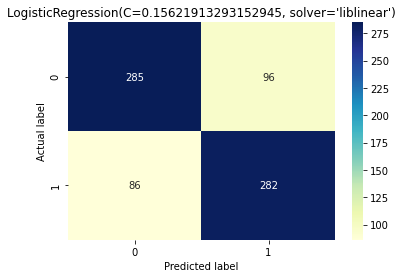

In [ ]:
model_performance(lgr, 'logisreg', X_train_mm_eval, y_train_eval)
scores_table(lgr, 'logisreg', X_train_mm_eval, y_train_eval)

# KNN

In [ ]:
knn = KNeighborsClassifier()

neighbors = list(range(1, 31))

# Another parameter besides k that we might vary is the weights parameters
# default options --> uniform (all points in the neighborhood are weighted equally)
# another option --> distance (weights closer neighbors more heavily than further neighbors)
weight_options = ['uniform', 'distance']
param_grid = dict(n_neighbors=neighbors, weights=weight_options)

In [ ]:
def gridSearch(X_train, X_test, model, hyperparameters, iter):
  name = ['X_train', 'X_train_mm', 'X_train_sd', 'X_train_fe_mm', 'X_train_fe_sd']
  GrSearch = GridSearch(X_train, y_train, model, hyperparameters)
  Prediction = GrSearch.BestModelPridict(X_test)
  print(f'prediction on test set trained with {name[i]} is ', ((y_test == Prediction).mean()))

In [ ]:
i = 0
for train, test in zip(experiment_X_train, experiment_X_test):
  gridSearch(train, test, knn, param_grid, i)
  i += 1

Best: 0.833189 using {'n_neighbors': 30, 'weights': 'distance'}
prediction on test set trained with X_train is  0.8031914893617021
Best: 0.837099 using {'n_neighbors': 1, 'weights': 'uniform'}
prediction on test set trained with X_train_mm is  0.75
Best: 0.833117 using {'n_neighbors': 20, 'weights': 'distance'}
prediction on test set trained with X_train_sd is  0.7978723404255319
Best: 0.845117 using {'n_neighbors': 23, 'weights': 'distance'}
prediction on test set trained with X_train_fe_mm is  0.7446808510638298
Best: 0.839784 using {'n_neighbors': 30, 'weights': 'distance'}
prediction on test set trained with X_train_fe_sd is  0.7978723404255319


In [ ]:
param = {'n_neighbors': 20, 'weights': 'distance'}
knn = KNeighborsClassifier(**param)

In [ ]:
knn.fit(X_train_sd, y_train)

KNeighborsClassifier(n_neighbors=20, weights='distance')

In [ ]:
filename_knn = 'knn_sd.sav'

joblib.dump(knn, filename_knn)

['knn_sd.sav']

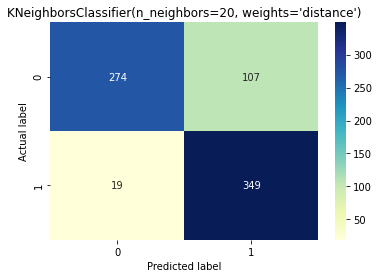

In [ ]:
model_performance(knn, 'knn', X_train_sd_eval, y_train_eval)
scores_table(knn, 'knn', X_train_sd_eval, y_train_eval)

# SVC

In [ ]:
svc = SVC()
c_values = [0.1, 0.3, 0.5, 0.7, 0.9, 1.0, 1.3, 1.5, 1.7, 2.0]
kernel_values = [ 'linear' , 'poly' , 'rbf' , 'sigmoid' ]
param_grid = dict(C=c_values, kernel=kernel_values)

In [ ]:
i = 0
for train, test in zip(experiment_X_train, experiment_X_test):
  gridSearch(train, test, svc, param_grid, i)
  i += 1

Best: 0.755694 using {'C': 0.9, 'kernel': 'linear'}
prediction on test set trained with X_train is  0.75
Best: 0.791748 using {'C': 1.3, 'kernel': 'rbf'}
prediction on test set trained with X_train_mm is  0.7819148936170213
Best: 0.793027 using {'C': 1.0, 'kernel': 'rbf'}
prediction on test set trained with X_train_sd is  0.8031914893617021
Best: 0.779694 using {'C': 1.3, 'kernel': 'poly'}
prediction on test set trained with X_train_fe_mm is  0.7553191489361702
Best: 0.797009 using {'C': 1.0, 'kernel': 'poly'}
prediction on test set trained with X_train_fe_sd is  0.7659574468085106


In [ ]:
param = {'C': 1.0, 'kernel': 'rbf'}
svc = SVC(**param, probability=True)

In [ ]:
svc.fit(X_train_sd, y_train)

SVC(probability=True)

In [ ]:
filename_svc = 'svc_sd.sav'

joblib.dump(svc, filename_svc)

['svc_sd.sav']

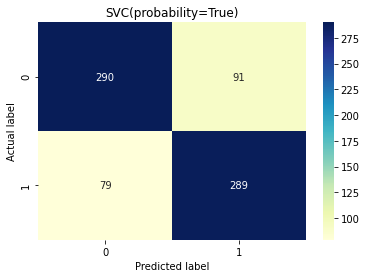

In [ ]:
model_performance(svc, 'svc', X_train_sd_eval, y_train_eval)
scores_table(svc, 'svc', X_train_sd_eval, y_train_eval)

# DecisionTree

In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
from scipy.stats import randint

decisionTree = DecisionTreeClassifier()

max_depth_value = [3, None]
max_features_value =  randint(1, 4)
min_samples_leaf_value = randint(1, 4)

criterion_value = ["gini", "entropy"]
param_grid = dict(max_depth = max_depth_value,
                  max_features = max_features_value,
                  min_samples_leaf = min_samples_leaf_value,
                  criterion = criterion_value)

In [ ]:
i = 0
for train, test in zip(experiment_X_train, experiment_X_test):
  randomSearch(train, test, decisionTree, param_grid, i)
  i += 1

Best: 0.847820 using {'criterion': 'entropy', 'max_depth': None, 'max_features': 2, 'min_samples_leaf': 1}
prediction on test set trained with X_train is  0.7978723404255319
Best: 0.846414 using {'criterion': 'entropy', 'max_depth': None, 'max_features': 2, 'min_samples_leaf': 1}
prediction on test set trained with X_train_mm is  0.7393617021276596
Best: 0.855820 using {'criterion': 'gini', 'max_depth': None, 'max_features': 3, 'min_samples_leaf': 1}
prediction on test set trained with X_train_sd is  0.8031914893617021
Best: 0.843748 using {'criterion': 'entropy', 'max_depth': None, 'max_features': 2, 'min_samples_leaf': 1}
prediction on test set trained with X_train_fe_mm is  0.5691489361702128
Best: 0.839730 using {'criterion': 'gini', 'max_depth': None, 'max_features': 2, 'min_samples_leaf': 1}
prediction on test set trained with X_train_fe_sd is  0.7393617021276596


In [ ]:
param = {'criterion': 'entropy', 'max_depth': None, 'max_features': 2, 'min_samples_leaf': 1}
decisionTree = DecisionTreeClassifier(**param)

In [ ]:
decisionTree.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_features=2)

In [ ]:
filename_dt = 'dt.sav'

joblib.dump(decisionTree, filename_dt)

['dt.sav']

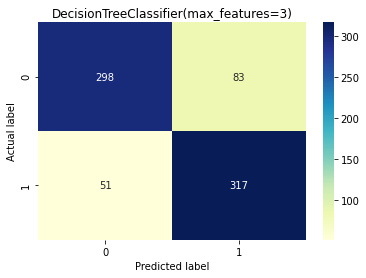

In [ ]:
model_performance(decisionTree, 'dt', X_train_sd_eval, y_train_eval)
scores_table(decisionTree, 'dt', X_train_sd_eval, y_train_eval)

# RandomForest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
rdf = RandomForestClassifier()

n_estimators_value = [100, 150]
min_samples_leaf_value =  randint(1, 4)

criterion_value = ["gini", "entropy"]
param_grid = dict(n_estimators = n_estimators_value,
                  min_samples_leaf = min_samples_leaf_value,
                  criterion = criterion_value)

In [ ]:
i = 0
for train, test in zip(experiment_X_train, experiment_X_test):
  randomSearch(train, test, rdf, param_grid, i)
  i += 1

Best: 0.881243 using {'criterion': 'gini', 'min_samples_leaf': 1, 'n_estimators': 150}
prediction on test set trained with X_train is  0.8776595744680851
Best: 0.877207 using {'criterion': 'gini', 'min_samples_leaf': 1, 'n_estimators': 100}
prediction on test set trained with X_train_mm is  0.8138297872340425
Best: 0.877207 using {'criterion': 'gini', 'min_samples_leaf': 1, 'n_estimators': 150}
prediction on test set trained with X_train_sd is  0.8723404255319149
Best: 0.875802 using {'criterion': 'gini', 'min_samples_leaf': 1, 'n_estimators': 150}
prediction on test set trained with X_train_fe_mm is  0.8138297872340425
Best: 0.878505 using {'criterion': 'entropy', 'min_samples_leaf': 1, 'n_estimators': 100}
prediction on test set trained with X_train_fe_sd is  0.8776595744680851


In [ ]:
param = {'criterion': 'gini', 'min_samples_leaf': 1, 'n_estimators': 150}
rdf = RandomForestClassifier(**param)

In [ ]:
rdf.fit(X_train, y_train)

RandomForestClassifier(n_estimators=150)

In [ ]:
filename_rdf = 'rdf.sav'

joblib.dump(rdf, filename_rdf)

['rdf.sav']

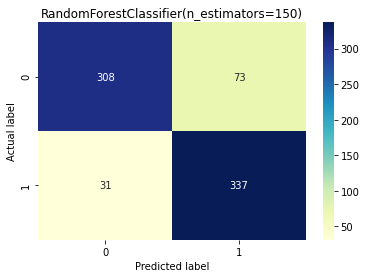

In [ ]:
model_performance(rdf, 'rdf', X_train_eval, y_train_eval)
scores_table(rdf, 'rdf', X_train_eval, y_train_eval)

# AdaBoost

In [ ]:
ada = AdaBoostClassifier()
learning_rate_value = [.01,.05,.1,.5,1]
n_estimators_value = [50,100,150,200,250,300]

param_grid = dict(learning_rate=learning_rate_value, n_estimators=n_estimators_value)

In [ ]:
i = 0
for train, test in zip(experiment_X_train, experiment_X_test):
  gridSearch(train, test, ada, param_grid, i)
  i += 1

Best: 0.802414 using {'learning_rate': 1, 'n_estimators': 150}
prediction on test set trained with X_train is  0.8031914893617021
Best: 0.803748 using {'learning_rate': 1, 'n_estimators': 300}
prediction on test set trained with X_train_mm is  0.5638297872340425
Best: 0.809081 using {'learning_rate': 1, 'n_estimators': 300}
prediction on test set trained with X_train_sd is  0.7712765957446809
Best: 0.805099 using {'learning_rate': 1, 'n_estimators': 200}
prediction on test set trained with X_train_fe_mm is  0.5585106382978723
Best: 0.809099 using {'learning_rate': 1, 'n_estimators': 200}
prediction on test set trained with X_train_fe_sd is  0.7446808510638298


In [ ]:
param = {'learning_rate': 1, 'n_estimators': 150}
ada = AdaBoostClassifier(**param)

In [ ]:
ada.fit(X_train, y_train)

AdaBoostClassifier(learning_rate=1, n_estimators=150)

In [ ]:
filename_ada = 'ada.sav'

joblib.dump(ada, filename_ada)

['ada.sav']

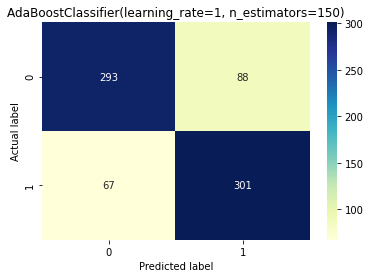

In [ ]:
model_performance(ada, 'ada', X_train_eval, y_train_eval)
scores_table(ada, 'ada', X_train_eval, y_train_eval)

# Voting Classifier

Voting is one of the simplest ways of combining the predictions from multiple machine learning algorithms. It works by first creating two or more standalone models from your training dataset. A Voting Classifier can then be used to wrap your models and average the predictions of the sub-models when asked to make predictions for new data.

In [ ]:
from sklearn.ensemble import VotingClassifier
from sklearn.model_selection import StratifiedKFold

In [ ]:
lgr = joblib.load('/content/lgr_mm.sav')
knn = joblib.load('/content/knn_sd.sav')
svc = joblib.load('/content/svc_fe_sd.sav')
dt = joblib.load('/content/dt.sav')
rdf = joblib.load('/content/rdf.sav')
ada = joblib.load('/content/ada.sav')


In [ ]:
estimators = [('LR',lgr), ('KNN', knn), ('SVC', svc),
              ('DT',dt), ('Rdf', rdf), ('Ada', ada)]

In [ ]:
ensemble = VotingClassifier(estimators)

In [ ]:
i = 0
for train, test in zip(experiment_X_train, experiment_X_test):
  name = ['X_train', 'X_train_mm', 'X_train_sd', 'X_train_fe_mm', 'X_train_fe_sd']
  kfold = StratifiedKFold(n_splits=10, random_state=42)
  ensemble = VotingClassifier(estimators)
  results = cross_val_score(ensemble, train, y_train, cv=kfold)
  print('Accuracy on train: ', results.mean())
  ensemble_model = ensemble.fit(train, y_train)
  pred = ensemble_model.predict(test)
  print(f'Accuracy on test (fit with {name[i]}):' , (y_test == pred).mean())
  i += 1

Accuracy on train:  0.8444736842105263
Accuracy on test (fit with X_train): 0.8359788359788359
Accuracy on train:  0.861701754385965
Accuracy on test (fit with X_train_mm): 0.7037037037037037
Accuracy on train:  0.8617368421052631
Accuracy on test (fit with X_train_sd): 0.8095238095238095
Accuracy on train:  0.8444035087719298
Accuracy on test (fit with X_train_fe_mm): 0.7248677248677249
Accuracy on train:  0.8617192982456141
Accuracy on test (fit with X_train_fe_sd): 0.783068783068783


In [ ]:
# from sklearn import metrics
# def cf_matrix(model, test_data):
#   y_pred = model.predict(test_data)
#   matrix = metrics.confusion_matrix(y_test, y_pred)  
#   p = sns.heatmap(pd.DataFrame(matrix), annot=True, cmap="YlGnBu" ,fmt='g')
#   plt.title(f'{model}', y=0.8)
#   plt.ylabel('Actual label')
#   plt.xlabel('Predicted label')
# #import confusion_matrix
# from sklearn.metrics import confusion_matrix
# #let us get the predictions using the classifier we had fit above
# y_pred = knn.predict(X_test)
# confusion_matrix(y_test,y_pred)
# pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True)
# import classification_report
# from sklearn.metrics import classification_report
# cr = classification_report(y_test, y_pred)

# LBGM

Gradient Boosting

In [ ]:
random_state=42

fit_params = {"early_stopping_rounds" : 100, 
             "eval_metric" : 'auc', 
             "eval_set" : [(X,y)],
             'eval_names': ['valid'],
             'verbose': 0,
             'categorical_feature': 'auto'}

param_test = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 1000, 1500, 2000],
              'num_leaves': sp_randint(6, 50), 
              'min_child_samples': sp_randint(100, 500), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'subsample': sp_uniform(loc=0.2, scale=0.8), 
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'colsample_bytree': sp_uniform(loc=0.4, scale=0.6),
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}

#number of combinations
n_iter = 300

#intialize lgbm and lunch the search
lgbm_clf = lgbm.LGBMClassifier(random_state=random_state, silent=True, metric='None', n_jobs=4)
grid_search = RandomizedSearchCV(
    estimator=lgbm_clf, param_distributions=param_test, 
    n_iter=n_iter,
    scoring='accuracy',
    cv=5,
    refit=True,
    random_state=random_state,
    verbose=True)

grid_search.fit(X_train, y_train, **fit_params)
opt_parameters =  grid_search.best_params_
lgbm_clf = lgbm.LGBMClassifier(**opt_parameters)

Fitting 5 folds for each of 300 candidates, totalling 1500 fits


In [ ]:
opt_parameters

{'colsample_bytree': 0.8484825628802539,
 'learning_rate': 0.2,
 'max_depth': 2,
 'min_child_samples': 106,
 'min_child_weight': 0.01,
 'n_estimators': 800,
 'num_leaves': 48,
 'reg_alpha': 0.1,
 'reg_lambda': 0.1,
 'subsample': 0.4833173366345004}

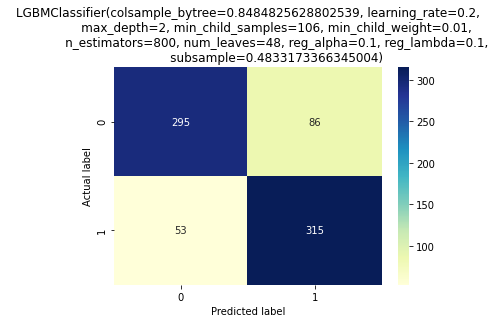

In [ ]:
model_performance(lgbm_clf, 'LightGBM', X_train_eval, y_train_eval)
scores_table(lgbm_clf, 'LightGBM', X_train_eval, y_train_eval)

In [ ]:
filename_lgbm = 'lgbm.sav'

joblib.dump(lgbm_clf, filename_lgbm)

['lgbm.sav']

# User Data Prediction

ML

In [ ]:
df[df['Outcome']==1].sample(4)

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
664,6,115,60,39,0,33.7,0.245,40,1
216,5,109,62,41,129,35.8,0.514,25,1
6,3,78,50,32,88,31.0,0.248,26,1
595,0,188,82,14,185,32.0,0.682,22,1


In [ ]:
user_data = {'Pregnancies': 5,
                        'Glucose': 109.0,
                        'BloodPressure': 62.0,
                        'SkinThickness': 41.0,
                        'Insulin': 129,
                        'BMI': 31.8,
                        'DiabetesPedigreeFunction': 0.514,
                        'Age': 26}

# Transform the data into a dataframe
ui = pd.DataFrame(user_data, index = [0])

Feature Engineering Function

In [ ]:
def set_bmi(data):
    row = data.copy(deep=True)
    row.loc[:,'BM_DESC_Healthy']=0
    row.loc[:,'BM_DESC_Obese']=0
    row.loc[:,'BM_DESC_Over']=0
    row.loc[:,'BM_DESC_Under']=0

    if row['BMI'].values < 18.5:
      row.loc[row['BMI'] < 18.5,'BM_DESC_Under'] = 1
    elif (row["BMI"].values >= 18.5) and (row["BMI"].values <= 24.9):
      row.loc[(row["BMI"] >= 18.5) & (row["BMI"] <= 24.9), 'BM_DESC_Healthy'] = 1
    elif (row["BMI"] >= 25).values and (row["BMI"].values <= 29.9):
      row.loc[(row["BMI"] >= 25) & (row["BMI"] <= 29.9), 'BM_DESC_Over'] = 1
    elif row["BMI"].values >= 30:
      row.loc[row["BMI"] >= 30, 'BM_DESC_Obese'] = 1

    return row
    
def set_insulin(row):
    row.loc[:,'INSULIN_DESC_Abnormal']=0
    row.loc[:,'INSULIN_DESC_Normal']=0
    if (row["Insulin"].values >= 16) and (row["Insulin"].values <= 166):
      row.loc[(row["Insulin"] >= 16) & (row["Insulin"] <= 166),'INSULIN_DESC_Normal'] = 1
    else:
      row.loc[:,'INSULIN_DESC_Abnormal']=1
    return row

In [ ]:
def prediction_result_ml(result, name):
  if np.argmax(result, axis=1) == 1:
    print(f"{name} Model Prediction [Result] : You have High Risk of diabetes")
    print(f"[Confidence Level] : {result[0][1]}")
  else:
    print(f"{name} Model Prediction [Result] : You are healthy")
    print(f"[Confidence Level] : {result[0][0]}")

class ModelPrediction:

  def __init__(self, model, name):
    self.model = model
    self.name = name

  def predict(self, user_data, deepLearning=False):
    if deepLearning == True:
      result = self.model.predict(user_data, verbose=0)
      prediction_result_dl(result, self.name)
    else:
      result = self.model.predict_proba(user_data)
      prediction_result_ml(result, self.name)
    
    

class Preprocessing:

  def __init__(self, user_data):
      self.user_data = user_data

  def feature_engineering(self, feat_en=False):
      if feat_en == True:
          data = set_bmi(self.user_data)
          data = set_insulin(data)
          data = pd.get_dummies(data)
      return data

  def scaling_method(self, scaler, data_to_transform):
      num_col = ['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age']
       
      try:
        scaled_data = scaler.transform(data_to_transform)
      except:
        scaled_data = pd.DataFrame(scaler.transform(data_to_transform[num_col]), columns=data_to_transform[num_col].columns, index=data_to_transform[num_col].index)
        bin_col = data_to_transform.drop(columns = num_col, axis=1)
        scaled_data = bin_col.merge(scaled_data, left_index=True, right_index=True, how="right")
        
      return scaled_data

Load Model

In [ ]:
lgr = joblib.load('/content/lgr_mm.sav')
knn = joblib.load('/content/knn_sd.sav')
svc = joblib.load('/content/svc_sd.sav')
dt = joblib.load('/content/dt.sav')
rdf = joblib.load('/content/rdf.sav')
ada = joblib.load('/content/ada.sav')

Preparing Data

In [ ]:
min_max_scaler = joblib.load('/content/MinMaxScaler().pkl')
standard_scaler = joblib.load('/content/StandardScaler().pkl')
df = Preprocessing(ui)
df_fe = df.feature_engineering(feat_en=True)
df_fe_sd = df.scaling_method(standard_scaler, df_fe)

df_sd = df.scaling_method(standard_scaler, ui)
df_mm = df.scaling_method(min_max_scaler, ui)

In [ ]:
df_mm

array([[0.33333333, 0.42207792, 0.31034483, 0.36956522, 0.13718412,
        0.43174603, 0.36846615, 0.09803922]])

In [ ]:
logisticReg = ModelPrediction(lgr, "LogisticRegression")
logisticReg.predict(df_mm)

KNN = ModelPrediction(knn, "KNN")
KNN.predict(df_sd)

supportVecM = ModelPrediction(svc, "SVC")
supportVecM.predict(df_sd)

DecisionTree = ModelPrediction(dt, "DecisionTree")
DecisionTree.predict(ui)

Adaboost = ModelPrediction(ada, "AdaBoost")
Adaboost.predict(ui)

RandomForest = ModelPrediction(rdf, "RandomForest")
RandomForest.predict(ui)

# nn_model = ModelPrediction(nn_model, "ANN Model", deepLearning=True)
# nn_model.predict(data_dl)

LogisticRegression Model Prediction [Result] : You are healthy
[Confidence Level] : 0.5610836366408704
KNN Model Prediction [Result] : You are healthy
[Confidence Level] : 0.7203245955423639
SVC Model Prediction [Result] : You are healthy
[Confidence Level] : 0.6233027192061633
DecisionTree Model Prediction [Result] : You are healthy
[Confidence Level] : 1.0
AdaBoost Model Prediction [Result] : You are healthy
[Confidence Level] : 0.5004620320466842
RandomForest Model Prediction [Result] : You are healthy
[Confidence Level] : 0.64


# RESOURCES

Metrics

https://www.kaggle.com/vipulgandhi/how-to-choose-right-metric-for-evaluating-ml-model

Ensemble

https://www.analyticsvidhya.com/blog/2018/06/comprehensive-guide-for-ensemble-models/

KNN

https://www.kaggle.com/shrutimechlearn/step-by-step-diabetes-classification-knn-detailed

Modeling

https://www.kaggle.com/vincentlugat/pima-indians-diabetes-eda-prediction-0-906

EDA

https://www.kaggle.com/nareshbhat/eda-within-snap-of-fingers